In [1]:
pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 974.8/974.8 kB 16.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 100.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 78.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 46.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 12.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 59.2 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstal

In [ ]:
from ultralytics import YOLO

# Load a model
model = YOLO("yolo11n-obb.pt")  # or use "yolo11n-obb.pt" if you're using a pre-trained OBB model

# Predict on a local image
results = model("/WhatsApp Image 2025-04-13 at 15.49.46 (1).jpeg")  # replace with your actual image path

# Access the results
for result in results:
    xywhr = result.keypoints.xy  # center-x, center-y, width, height, angle (radians)
    xyxyxyxy = result.obb.xyxyxyxy  # polygon format with 4-points
    names = [result.names[cls.item()] for cls in result.obb.cls.int()]  # class name of each box
    confs = result.obb.conf  # confidence score of each box


image 1/1 /WhatsApp Image 2025-04-13 at 15.49.46 (1).jpeg: 576x1024 179.0ms
Speed: 3.4ms preprocess, 179.0ms inference, 0.9ms postprocess per image at shape (1, 3, 576, 1024)


AttributeError: 'NoneType' object has no attribute 'xy'

In [ ]:
from ultralytics import YOLO

# Load the model
model = YOLO("yolo11n-obb.pt")

# Predict on local image
results = model("/WhatsApp Image 2025-04-13 at 15.49.46 (1).jpeg")

# Access the results
for result in results:
    # Get oriented bounding boxes (OBBs)
    obb = result.obb

    if obb is not None:
        xyxyxyxy = obb.xyxyxyxy  # polygon format with 4 points
        names = [result.names[cls.item()] for cls in obb.cls.int()]  # class names
        confs = obb.conf  # confidence scores

        print("Polygon OBBs:", xyxyxyxy)
        print("Class names:", names)
        print("Confidences:", confs)
    else:
        print("No oriented bounding boxes detected.")

    # If keypoints are needed (only if model supports them)
    if result.keypoints is not None:
        xywhr = result.keypoints.xy
        print("Keypoints (xywhr):", xywhr)



image 1/1 /WhatsApp Image 2025-04-13 at 15.49.46 (1).jpeg: 576x1024 182.9ms
Speed: 3.7ms preprocess, 182.9ms inference, 1.0ms postprocess per image at shape (1, 3, 576, 1024)
Polygon OBBs: tensor([[[3106.6123, 1751.8219],
         [3123.3823, 1708.5624],
         [2884.6167, 1616.0023],
         [2867.8467, 1659.2618]]])
Class names: ['large vehicle']
Confidences: tensor([0.5722])


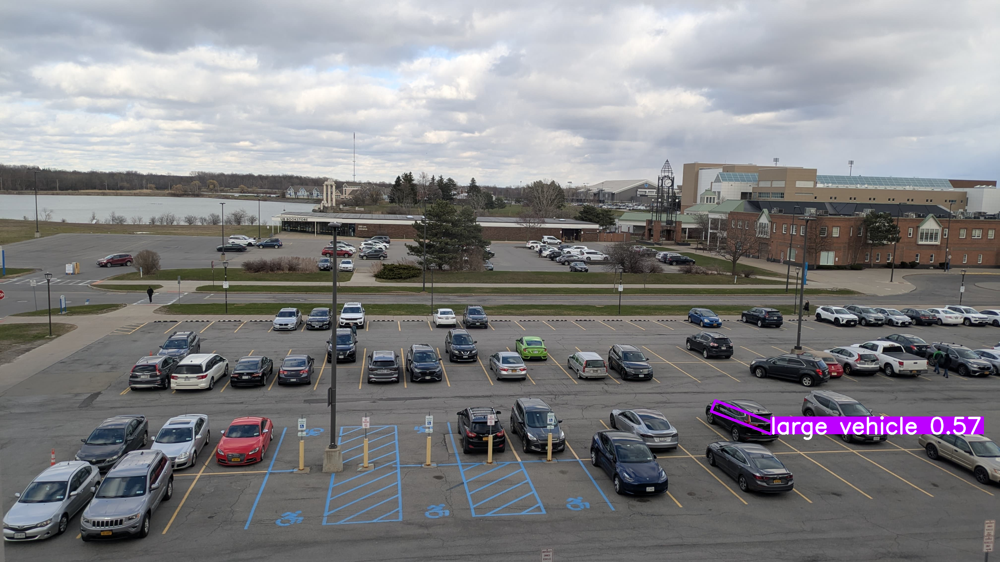

In [ ]:
results[0].plot()  # returns an annotated image (numpy array)
results[0].show()  # displays the image in a window (only if supported)


In [ ]:
from ultralytics import YOLO
import cv2
import os
import numpy as np
import random

def detect_vehicles_with_segmentation(input_image_path, output_image_path, model_path):
    # Load the chosen YOLOv8 segmentation model
    print(f"Loading model: {model_path}")
    model = YOLO(model_path)

    # Read the input image
    image = cv2.imread(input_image_path)
    if image is None:
        raise ValueError(f"Could not load image at {input_image_path}")
    print(f"Input image loaded: {input_image_path}, shape: {image.shape}")

    # Optionally, you might want to resize the image for better detection on small vehicles
    # image = cv2.resize(image, (1280, 1280))

    # Perform inference with a set confidence threshold (you can tune this value)
    results = model.predict(source=input_image_path, conf=0.3, iou=0.45, verbose=True)
    print(f"Prediction completed. Number of results: {len(results)}")

    # Process results
    annotated_image = image.copy()
    detections_found = False
    combined_mask_color = np.zeros_like(image, dtype=np.uint8)  # To accumulate masks
    boxes_to_draw = []

    # Loop over each result (could be multiple if processing a batch)
    for result in results:
        # Process bounding boxes (detections)
        if hasattr(result, 'boxes') and result.boxes is not None:
            print(f"Boxes detected: {len(result.boxes)}")
            for box, conf, cls in zip(result.boxes.xyxy, result.boxes.conf, result.boxes.cls):
                if int(cls) in [2, 7]:  # COCO class IDs for vehicles: 2=car, 7=truck
                    detections_found = True
                    x1, y1, x2, y2 = map(int, box)
                    label = f"Vehicle {conf:.2f} (Class: {int(cls)})"
                    boxes_to_draw.append((x1, y1, x2, y2, label))
                    print(f"Detection: {label}, Box: ({x1}, {y1}, {x2}, {y2})")

        # Process segmentation masks for each detection
        if hasattr(result, 'masks') and result.masks is not None:
            print(f"Masks detected: {len(result.masks)}")
            for mask, conf, cls in zip(result.masks.data, result.boxes.conf, result.boxes.cls):
                if int(cls) in [2, 7]:
                    mask = mask.cpu().numpy()  # Convert from tensor to NumPy array
                    mask = cv2.resize(mask, (image.shape[1], image.shape[0]))  # Resize to match the image
                    mask = mask > 0.5  # Binarize mask with threshold

                    # Generate a random color for each mask
                    color = (random.randint(0, 255), random.randint(0, 255), random.randint(0, 255))
                    combined_mask_color[mask] = color

    # Blend the combined colored masks with the original image (using 30% transparency)
    if detections_found:
        alpha = 0.3  # Transparency for the mask
        beta = 1.0 - alpha
        cv2.addWeighted(annotated_image, beta, combined_mask_color, alpha, 0.0, annotated_image)

    # Draw bounding boxes and labels on top of the blended image
    for x1, y1, x2, y2, label in boxes_to_draw:
        cv2.rectangle(annotated_image, (x1, y1), (x2, y2), (0, 255, 0), 2)
        # Place the label above the box if there is space; otherwise, below the box
        label_y = y1 - 10 if y1 - 10 > 10 else y2 + 20
        cv2.putText(annotated_image, label, (x1, label_y),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

    if not detections_found:
        print("No vehicles detected. Try lowering the confidence threshold or fine-tuning the model.")

    # Save the annotated image
    cv2.imwrite(output_image_path, annotated_image)
    print(f"Output image saved to {output_image_path}")
    return annotated_image

if __name__ == "__main__":
    # Example usage: change the model_path to try different variants
    input_path = "/WhatsApp Image 2025-04-13 at 15.49.46 (1).jpeg"   # Replace with your input image path
    output_path = "output_detected_seg.jpg" # Output image path

    # Change the model here: choose among "yolov8n-seg.pt", "yolov8s-seg.pt", "yolov8m-seg.pt", "yolov8l-seg.pt", "yolov8x-seg.pt"
    model_path = "yolo11n-obb.pt"  # Example: using the nano variant

    if not os.path.exists(input_path):
        print(f"Input image {input_path} not found. Please provide a valid image.")
    else:
        detect_vehicles_with_segmentation(input_path, output_path, model_path)


Loading model: yolo11n-obb.pt
Input image loaded: /WhatsApp Image 2025-04-13 at 15.49.46 (1).jpeg, shape: (2268, 4032, 3)

image 1/1 /WhatsApp Image 2025-04-13 at 15.49.46 (1).jpeg: 576x1024 357.2ms
Speed: 12.8ms preprocess, 357.2ms inference, 14.0ms postprocess per image at shape (1, 3, 576, 1024)
Prediction completed. Number of results: 1
No vehicles detected. Try lowering the confidence threshold or fine-tuning the model.
Output image saved to output_detected_seg.jpg


In [ ]:
from ultralytics import YOLO
import cv2
import numpy as np

def detect_vehicles_yolo_obb(input_image_path, output_image_path, model_path):
    print(f"Loading YOLOv11 OBB model from: {model_path}")
    model = YOLO(model_path)

    image = cv2.imread(input_image_path)
    if image is None:
        raise ValueError(f"Could not load image at {input_image_path}")
    print(f"Image loaded: {input_image_path}, shape: {image.shape}")

    results = model.predict(source=input_image_path, conf=0.3, iou=0.45, verbose=True)
    annotated_image = image.copy()

    # Define vehicle class IDs (update based on your training data)
    vehicle_classes = [2, 5, 7]  # Example for COCO: 2=car, 5=bus, 7=truck

    for result in results:
        if hasattr(result, 'obb') and result.obb is not None:
            boxes = result.obb.xyxyxyxy  # 8-point rotated box
            classes = result.obb.cls
            confidences = result.obb.conf

            for box, cls_id, conf in zip(boxes, classes, confidences):
                if int(cls_id) in vehicle_classes:
                    # Convert 8-point box to int32
                    points = np.array(box).reshape((4, 2)).astype(np.int32)

                    # Draw rotated box
                    cv2.polylines(annotated_image, [points], isClosed=True, color=(0, 255, 0), thickness=2)

                    # Add label
                    label = f"{model.names[int(cls_id)]} {conf:.2f}"
                    label_pos = tuple(points[0])
                    cv2.putText(annotated_image, label, label_pos, cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 0), 2)

    # Save result
    cv2.imwrite(output_image_path, annotated_image)
    print(f"Annotated image saved to {output_image_path}")
    return annotated_image


In [5]:
from ultralytics import YOLO
import cv2
import os
import numpy as np
import random

def detect_vehicles_with_obb(input_image_path, output_image_path, model_path):
    # Load the OBB model
    print(f"Loading OBB model: {model_path}")
    model = YOLO(model_path)

    # Load image
    image = cv2.imread(input_image_path)
    if image is None:
        raise ValueError(f"Could not load image at {input_image_path}")
    print(f"Image loaded: {input_image_path}, shape: {image.shape}")

    # Run inference
    results = model.predict(source=input_image_path, conf=0.3, iou=0.45, verbose=True)
    print(f"Prediction done. Number of result sets: {len(results)}")

    # Prepare image for annotation
    annotated_image = image.copy()
    detections_found = False

    for result in results:
        obb = result.obb

        if obb is not None and obb.xyxyxyxy is not None:
            xyxyxyxy = obb.xyxyxyxy.cpu().numpy().astype(int)  # shape: (N, 8)
            classes = obb.cls.int().cpu().numpy()
            confs = obb.conf.cpu().numpy()

            for i in range(len(xyxyxyxy)):
                cls_id = classes[i]
                conf = confs[i]
                polygon = xyxyxyxy[i].reshape(4, 2)  # (4,2)

                # COCO class IDs: 2 = car, 7 = truck
                if cls_id in [2, 7]:
                    detections_found = True

                    # Draw polygon
                    cv2.polylines(annotated_image, [polygon], isClosed=True, color=(0, 255, 0), thickness=2)

                    # Draw label
                    label = f"Vehicle {conf:.2f}"
                    cx, cy = polygon[0]
                    cv2.putText(annotated_image, label, (cx, cy - 10), cv2.FONT_HERSHEY_SIMPLEX,
                                0.5, (0, 255, 0), 2)
                    print(f"Detected Vehicle - Conf: {conf:.2f}, Polygon: {polygon.tolist()}")

        else:
            print("No OBBs found in this result.")

    if not detections_found:
        print("No vehicles detected in the image.")

    # Save output
    cv2.imwrite(output_image_path, annotated_image)
    print(f"Annotated image saved to: {output_image_path}")
    return annotated_image

if __name__ == "__main__":
    input_path = "/WhatsApp Image 2025-04-13 at 15.49.46 (1).jpeg"  # Your test image
    output_path = "output_obb_detected.jpg"
    model_path = "yolo11x-obb.pt"  # Try the 'x' variant for best performance

    if not os.path.exists(input_path):
        print(f"Input image {input_path} not found.")
    else:
        detect_vehicles_with_obb(input_path, output_path, model_path)


Loading OBB model: yolo11x-obb.pt
Image loaded: /WhatsApp Image 2025-04-13 at 15.49.46 (1).jpeg, shape: (2268, 4032, 3)

image 1/1 /WhatsApp Image 2025-04-13 at 15.49.46 (1).jpeg: 576x1024 5151.3ms
Speed: 7.6ms preprocess, 5151.3ms inference, 3.5ms postprocess per image at shape (1, 3, 576, 1024)
Prediction done. Number of result sets: 1
No vehicles detected in the image.
Annotated image saved to: output_obb_detected.jpg


YOLO E Series tried by zero shot infernce.

100%|██████████| 67.7M/67.7M [00:00<00:00, 147MB/s]


requirements: Ultralytics requirement ['git+https://github.com/ultralytics/CLIP.git'] not found, attempting AutoUpdate...
  Cloning https://github.com/ultralytics/CLIP.git to /tmp/pip-req-build-0x5kop5c
  Resolved https://github.com/ultralytics/CLIP.git to commit d19bfc14081d768afe1e4379609444c472f4b38e
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.8/44.8 kB 3.2 MB/s eta 0:00:00
  Created wheel for clip: filename=clip-1.0-py3-none-any.whl size=1382443 sha256=fe3cb22ad17cbb166ab7b0efc4228c215dc90ca6e0096c778816a84950aac2ef
  Stored in directory: /tmp/pip-ephem-wheel-cache-q2ilwyxm/wheels/04/89/1d/c5712518ddb082b177c25dd0e1119b6a1c45ea1ab4e7fcd8a6
Successfully built clip

requirements: AutoUpdate success ✅ 7.1s, installed 1 package: ['git+https://github.com/ultralytics/CLIP.git']
requirements: ⚠️ Restart runtime or rerun command for updates to take effect

requirements: Ultralytics requ

/usr/local/lib/python3.11/dist-packages/timm/models/layers/__init__.py:48: FutureWarning: Importing from timm.models.layers is deprecated, please import via timm.layers
  warnings.warn(f"Importing from {__name__} is deprecated, please import via timm.layers", FutureWarning)


100%|██████████| 571M/571M [00:07<00:00, 77.0MB/s]


Ultralytics 8.3.108 🚀 Python-3.11.12 torch-2.6.0+cu124 CPU (Intel Xeon 2.20GHz)
YOLOe-11l-seg summary (fused): 227 layers, 35,117,862 parameters, 2,254,374 gradients, 144.1 GFLOPs

image 1/1 /WhatsApp Image 2025-04-13 at 15.49.46 (1).jpeg: 384x640 (no detections), 1472.6ms
Speed: 3.8ms preprocess, 1472.6ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)


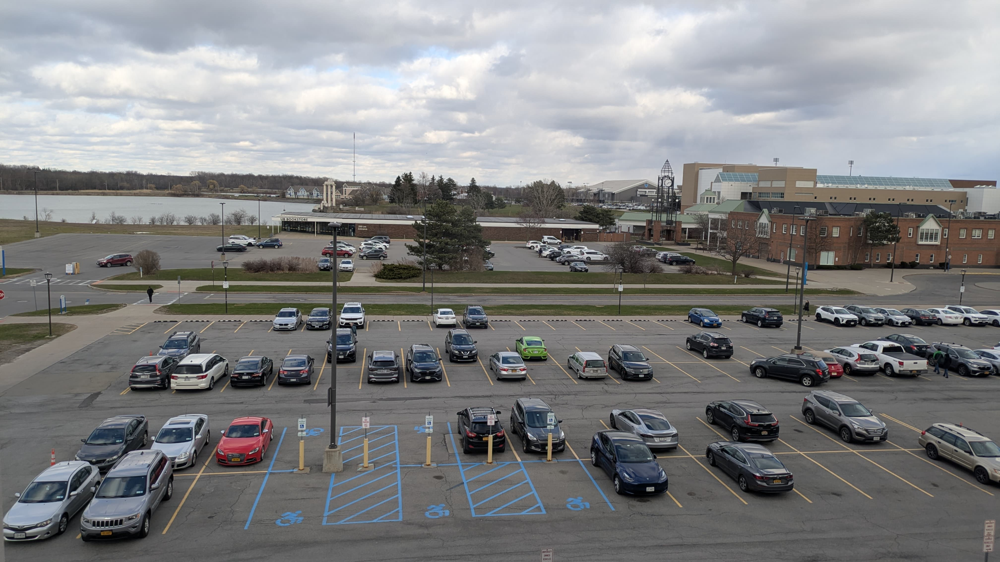

In [6]:
from ultralytics import YOLOE

# Initialize a YOLOE model
model = YOLOE("yoloe-11l-seg.pt")  # or select yoloe-11s/m-seg.pt for different sizes

# Set text prompt
names = ["person", "bus"]
model.set_classes(names, model.get_text_pe(names))

# Execute prediction for specified categories on an image
results = model.predict("/WhatsApp Image 2025-04-13 at 15.49.46 (1).jpeg")

# Show results
results[0].show()